# NTLK

## Part 2: Community detection 

**Explain the concept of modularity in your own words.**

Modularity quantifies how well a network is divided into communities by comparing the density of edges inside communities to edges between communities. High modularity values indicate that there are more connections within communities than would be expected in a random network with the same node degree distribution. This makes modularity a useful metric for identifying meaningful communities in networks.

In [4]:
# load artist genres dictionary
import json

def load_artist_genres_dict():
    artist_genres_dict = {}
    with open('artists_genres_dictionary.txt', 'r') as f:
        artist_genres_dict = json.load(f)
    return artist_genres_dict

artists = load_artist_genres_dict()
print(len(artists))
print(artists)

1833
{'A Thousand Horses': ['country', 'country rock', 'southern rock'], 'A.P. Carter': ['country', 'folk', 'gospel'], 'Aaron Barker': ['country'], 'Aaron Benward': ['country', 'christian music'], 'Aaron Lewis (musician)': ['alternative metal', 'post-grunge', 'nu metal', 'country rock', 'alternative country'], 'Aaron Lines': ['country'], 'Aaron Neville': ['soul', 'country', 'gospel', 'jazz', 'pop'], 'Aaron Pritchett': ['country'], 'Aaron Watson': ['country', 'red dirt', 'texas country'], 'Ace in the Hole Band': ['alternative country', 'neotraditional country', 'western swing'], 'Adam Brand (musician)': ['country'], 'Adam Gregory': ['country music'], 'Adam Harvey': ['country'], 'Adrienne Young': ['bluegrass', 'country', 'old-time music', 'american folk music'], 'Al Anderson (NRBQ)': ['rock', 'country'], 'Al Caiola': ['jazz', 'country', 'rock', 'pop'], 'Al Dexter': ['country'], 'Al Downing (musician)': ['rockabilly', 'rock and roll', 'blues', 'rhythm and blues', 'country', 'gospel'], 'Al

In [12]:
import pickle

# Load the graph from the pickle file
with open('../lab5/artist_graph.pkl', 'rb') as f:
    G = pickle.load(f)

# make the graph undirected
G = G.to_undirected()
print(G.number_of_nodes())

rm_nodes = []

for node in G.nodes():
    if node.replace('_', ' ') in artists.keys():
        G.nodes[node]['genre'] = artists[node.replace('_', ' ')][0]
    else:
        rm_nodes.append(node)

for node in rm_nodes:
    G.remove_node(node)

print(G.number_of_nodes())
print(G.number_of_edges())
print(G.nodes(data=True))

2098
1829
[('Haley_&_Michaels', {'len_content': 1370, 'genre': 'country'}), ('Dickey_Betts', {'len_content': 4911, 'genre': 'rock'}), ('Two_Tons_of_Steel', {'len_content': 522, 'genre': 'country'}), ('Bacon_Brothers', {'len_content': 101, 'genre': 'country rock'}), ('Cledus_T._Judd', {'len_content': 5373, 'genre': 'country'}), ('Charlie_Major', {'len_content': 932, 'genre': 'country'}), ('Caryl_Mack_Parker', {'len_content': 752, 'genre': 'country'}), ('Tenille_Arts', {'len_content': 4681, 'genre': 'country'}), ('Tyler_Hubbard', {'len_content': 4453, 'genre': 'country'}), ('Steven_Lee_Olsen', {'len_content': 2802, 'genre': 'country'}), ('O._B._McClinton', {'len_content': 1789, 'genre': 'country'}), ('JT_Hodges', {'len_content': 1991, 'genre': 'country'}), ('Hank_Flamingo', {'len_content': 1029, 'genre': 'country'}), ('Shawn_Camp_(singer)', {'len_content': 1678, 'genre': 'country'}), ('Valerie_June', {'len_content': 4844, 'genre': 'americana'}), ('Roxie_Dean', {'len_content': 995, 'genre

In [19]:
from collections import defaultdict
from networkx.algorithms.community.quality import modularity


# Create a dictionary to hold communities based on the 'category' attribute
communities = defaultdict(list)

# Group nodes by the 'category' attribute
for node, data in G.nodes(data=True):
    category = data['genre']
    communities[category].append(node)

# Convert communities to a list of lists
communities_list = list(communities.values())

# Calculate modularity
mod = modularity(G, communities_list)
print(F"Modularity of the graph: {mod}")

# calculate modularity based on equation
# M is the modularity.
# nc is the number of communities.
# Lc is the number of edges within community 
# L is the total number of edges in the graph.
# kc is the sum of the degrees of all nodes in community 
# Total number of edges in the graph
L = G.number_of_edges()

# Modularity calculation based on the given formula
M = 0
for community in communities_list:
    # Subgraph of the current community
    subgraph = G.subgraph(community)
    
    # L_c: Number of edges inside this community
    L_c = subgraph.number_of_edges()
    
    # k_c: Sum of the degrees of the nodes in this community
    k_c = sum(dict(G.degree(community)).values())
    
    # Apply the modularity formula
    M += (L_c / L) - (k_c / (2 * L))**2

# Print the modularity
print(f"Modularity based on formula: {M}")


Modularity of the graph: 0.07113789914793135
Modularity based on formula: 0.07113789914793132


The higher is M for a partition, the better is the corresponding community structure. Therefore in our case since M is close to zero this means that there is almost only one community, and as mentioned in the teachers nb this is due to the fact that country is the first genre for most of the artists. If we removed this genre maybe the modularity gets better.

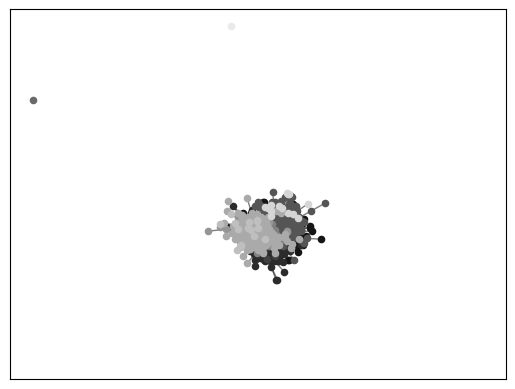

In [21]:
import community
import networkx as nx
import matplotlib.pyplot as plt

#better with karate_graph() as defined in networkx example.
#erdos renyi don't have true community structure
# G = nx.erdos_renyi_graph(30, 0.05)

# first compute the best partition
partition = community.best_partition(G)

# drawing
size = float(len(set(partition.values())))
pos = nx.spring_layout(G)
count = 0.
for com in set(partition.values()) :
    count = count + 1.
    list_nodes = [nodes for nodes in partition.keys()
                                if partition[nodes] == com]
    nx.draw_networkx_nodes(G, pos, list_nodes, node_size = 20,
                                node_color = str(count / size))


nx.draw_networkx_edges(G,pos, alpha=0.5)
plt.show()

In [23]:
# calculate the modularity of the partition
mod = community.modularity(partition, G)
print(F"Modularity of the partition by Louvain-algorithm: {mod}")

Modularity of the partition by Louvain-algorithm: 0.3897917379084557


The value is higher that the one founded above, I believe because the Louvain algorithm compares different partitions and keeps the one with higher modularity.

In [28]:
import fa2_modified as fa2

# Group nodes by their community and calculate the size of each community
community_sizes = {}
for node, comm in partition.items():
    if comm not in community_sizes:
        community_sizes[comm] = 0
    community_sizes[comm] += 1

# Sort communities by size and get the largest 10 communities
largest_communities = sorted(community_sizes, key=community_sizes.get, reverse=True)[:10]

# Assign colors to nodes
# Color nodes in the largest communities with distinct colors, and others with a light gray color
node_colors = []
for node in G.nodes():
    community = partition[node]
    if community in largest_communities:
        # Assign a unique color to the community
        node_colors.append(largest_communities.index(community) / len(largest_communities))
    else:
        # Assign light gray to small communities
        node_colors.append(0.85)  # Light gray

# Apply the Force Atlas 2 algorithm to layout the graph
forceatlas2 = fa2.ForceAtlas2(
    outboundAttractionDistribution=False,  # Dissuade hubs
    linLogMode=False,  # Linear distances between nodes
    adjustSizes=False,  # Don't account for node sizes
    edgeWeightInfluence=1.0,
    jitterTolerance=1.0,  # Tolerance for node overlapping
    barnesHutOptimize=True,
    barnesHutTheta=1.2,
    scalingRatio=2.0,
    strongGravityMode=False,
    gravity=1.0
)

# Get positions for nodes using Force Atlas 2
positions = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=2000)


100%|██████████| 2000/2000 [01:03<00:00, 31.56it/s]

BarnesHut Approximation  took  5.22  seconds
Repulsion forces  took  55.25  seconds
Gravitational forces  took  0.28  seconds
Attraction forces  took  0.29  seconds
AdjustSpeedAndApplyForces step  took  1.38  seconds


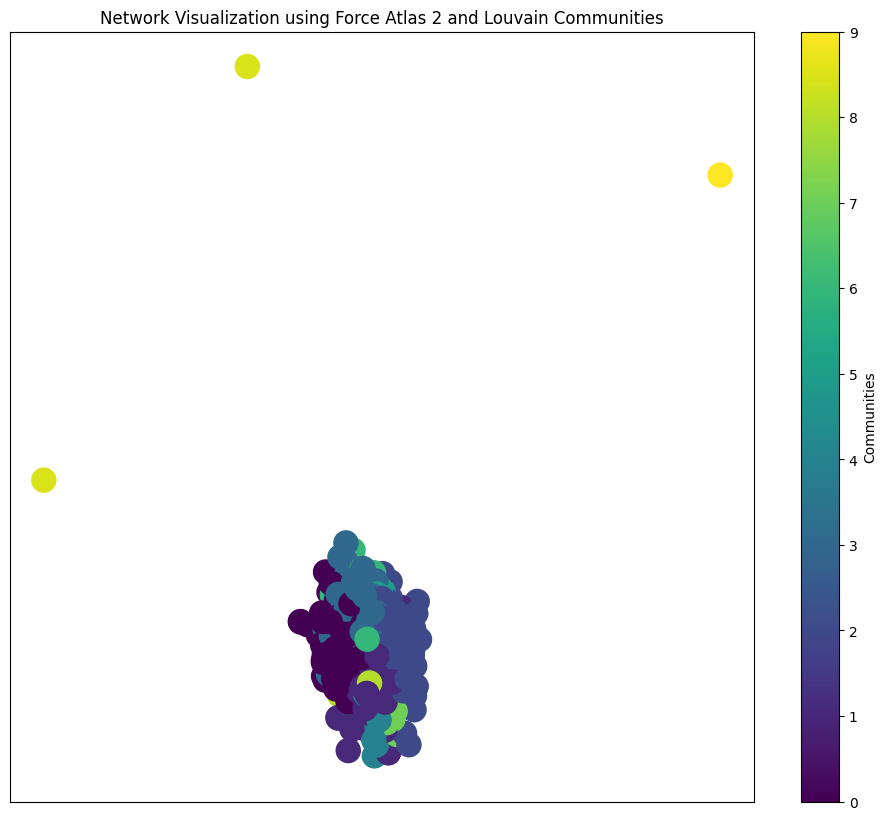

In [29]:
# set the colormap
cmap = plt.cm.viridis

# Create the scalar mappable (for the color bar)
sm = plt.cm.ScalarMappable(cmap=cmap)
sm.set_array(largest_communities)

# Plot the graph
fig, ax = plt.subplots(figsize=(12, 10))

# Draw nodes
nx.draw_networkx_nodes(G, positions, node_color=node_colors, cmap=cmap, node_size=300)

# Draw edges
nx.draw_networkx_edges(G, positions, alpha=0.5)

# Show plot
plt.title("Network Visualization using Force Atlas 2 and Louvain Communities")

# Add the color bar to the specific axis
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Communities', color='black')  # Color of the color bar label

ax.tick_params(colors='black')

plt.show()

EXPLAIN GRAPH

In [30]:
# Graph with all genres
# Load the graph from the pickle file
with open('../lab5/artist_graph.pkl', 'rb') as f:
    G_all = pickle.load(f)

# make the graph undirected
G_all = G_all.to_undirected()
print(G_all.number_of_nodes())

rm_nodes = []

for node in G_all.nodes():
    if node.replace('_', ' ') in artists.keys():
        G_all.nodes[node]['genre'] = artists[node.replace('_', ' ')]
    else:
        rm_nodes.append(node)

for node in rm_nodes:
    G_all.remove_node(node)

print(G_all.number_of_nodes())
print(G_all.nodes(data=True))

2098
1829
[('Haley_&_Michaels', {'len_content': 1370, 'genre': ['country']}), ('Dickey_Betts', {'len_content': 4911, 'genre': ['rock', 'country', 'blues', 'jazz', 'southern rock', 'jam band']}), ('Two_Tons_of_Steel', {'len_content': 522, 'genre': ['country', 'alternative country', 'americana', 'rockabilly']}), ('Bacon_Brothers', {'len_content': 101, 'genre': ['country rock', 'folk rock']}), ('Cledus_T._Judd', {'len_content': 5373, 'genre': ['country', 'parody']}), ('Charlie_Major', {'len_content': 932, 'genre': ['country']}), ('Caryl_Mack_Parker', {'len_content': 752, 'genre': ['country']}), ('Tenille_Arts', {'len_content': 4681, 'genre': ['country']}), ('Tyler_Hubbard', {'len_content': 4453, 'genre': ['country', 'country pop', 'country rock']}), ('Steven_Lee_Olsen', {'len_content': 2802, 'genre': ['country']}), ('O._B._McClinton', {'len_content': 1789, 'genre': ['country']}), ('JT_Hodges', {'len_content': 1991, 'genre': ['country']}), ('Hank_Flamingo', {'len_content': 1029, 'genre': [

In [40]:
import numpy as np
from collections import Counter
import community

# Graph with all genres G_all

# Apply the Louvain algorithm to detect communities
partition = community.best_partition(G_all)

# Identify the 7 most common genres
genres = []
genres_1 = [data['genre'] for _, data in G_all.nodes(data=True)]
for i in range(len(genres_1)):
    for genre in genres_1[i]:
        genres.append(genre)

genre_counter = Counter(genres)
top_7_genres = [g for g, _ in genre_counter.most_common(7)]
print(top_7_genres)

# Identify the 7 largest communities
community_counter = Counter(partition.values())
top_7_communities = [c for c, _ in community_counter.most_common(7)]
print(top_7_communities)

# Initialize the confusion matrix (7 x 7)
confusion_matrix = np.zeros((7, 7), dtype=int)

# Populate the confusion matrix
for node, data in G_all.nodes(data=True):
    genre = data['genre']
    community = partition[node]

    # For all genres of a node
    # Check if the genre is in the top 7 genres and the community is in the top 7 communities
    for g in genre:
        if g in top_7_genres and community in top_7_communities:
            genre_idx = top_7_genres.index(g)
            community_idx = top_7_communities.index(community)
            confusion_matrix[genre_idx, community_idx] += 1

# Display the confusion matrix
print("Confusion Matrix (Genres x Communities):")
print(confusion_matrix)

# Analysis of the matrix
# for i, genre in enumerate(top_7_genres):
#     for j, community in enumerate(top_7_communities):
#         print(f"Genre '{genre}' and Community '{community}': {confusion_matrix[i, j]} common nodes")


['country', 'folk', 'country rock', 'americana', 'pop', 'bluegrass', 'rock']
[0, 3, 1, 2, 5, 7, 6]
Confusion Matrix (Genres x Communities):
[[481 352 332 213  63  24  14]
 [ 19   9  28  94  23   1   0]
 [ 32  53  15  64   3   3   0]
 [ 17  15  13  93  14   1   0]
 [ 33  49  47  20   4   2   1]
 [ 26   9   9  30  53   0   0]
 [ 24  23  17  42   4   3   0]]


## Part 3: Words that characterize pages or groups of pages

In [47]:
# Get the top 15 genres
top_15_genres = [g for g, _ in genre_counter.most_common(15)]
print(top_15_genres)

# Just run once because it appends the data to the file
for node in G.nodes():
    genre = G.nodes[node]['genre']

    if genre in top_15_genres:
        # read the file with the node's name
        with open(f'../lab4/artist_data/{node}.txt', 'r') as f:
            data = f.read()
        
        # append the data to the genre txt file
        with open(f'genres/{genre.replace(' ', '_')}.txt', 'a') as f:
            f.write(data)    

['country', 'folk', 'country rock', 'americana', 'pop', 'bluegrass', 'rock', 'country pop', 'gospel', 'rockabilly', 'blues', 'alternative country', 'folk rock', 'southern rock', 'rock and roll']


In [94]:
import os
import string
import nltk
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

# nltk.download('stopwords')

# set the lemmatizer
lemmatizer = WordNetLemmatizer()

stopwords = nltk.corpus.stopwords.words('english')

# quotes
quotes = ['``', "''", '’', '""', '“', '”']

# n thinks
n_scape = '\\n'

# wiki-syntax
wiki_syntax = ['https', 'ref', 'url', 'n', 'wa', 'cite', "'s" ]

# for every file in genres folder
for filename in os.listdir('genres'):
    # read the file
    with open(f'genres/{filename}', 'r') as f:
        data = f.read()
    
    # tokenize the data
    tokens = word_tokenize(data)

    # remove punctuation and make all words lowercase
    tokens = [word.lower() for word in tokens if word not in string.punctuation]

    # lemmatize the words
    tokens = [lemmatizer.lemmatize(word).lower() for word in tokens]
    total_words = len(tokens)

    # remove stopwords
    tokens = [word for word in tokens if word not in stopwords]

    # remove words that are len 1
    tokens = [word for word in tokens if len(word) > 1]

    # remove quotes
    tokens = [word for word in tokens if word not in quotes]

    # remove \n
    tokens = [word for word in tokens if n_scape not in word]

    # remove urls
    tokens = [word for word in tokens if '/' not in word]
    tokens = [word for word in tokens if 'www' not in word]
    tokens = [word for word in tokens if 'url' not in word]

    # remove words that contain = 
    tokens = [word for word in tokens if '=' not in word]

    # remove words contains : 
    tokens = [word for word in tokens if ':' not in word]

    # remove starting |
    # tokens = [word.replace('|', '') for word in tokens if word[0] == '|']

    # remove ending \
    # tokens = [word.replace('\\', '') for word in tokens if word[-1] == '\\']

    # split words by | if they contain |
    # tokens = [word.split('|') for word in tokens]

    # remove wiki syntax
    tokens = [word for word in tokens if word not in wiki_syntax]

    # count the tokens
    token_counter = Counter(tokens)

    # remove words that appear less than 5 times
    token_counter = {token: count for token, count in token_counter.items() if count >= 5}

    # save in a new file the tokens and their count
    with open(f'tf_raw_counts/{filename}', 'w') as f:
        for token, count in token_counter.items():
            f.write(f"{token}   {count}\n")

    # create tf_idf
    with open(f'tf_term_freqs/{filename}', 'w') as f:
        for token, count in token_counter.items():
            # calculate the frequency with .2f precision
            frequency = count/total_words
            f.write(f"{token}   {frequency:.5f}\n")


## Part 4: Visualization

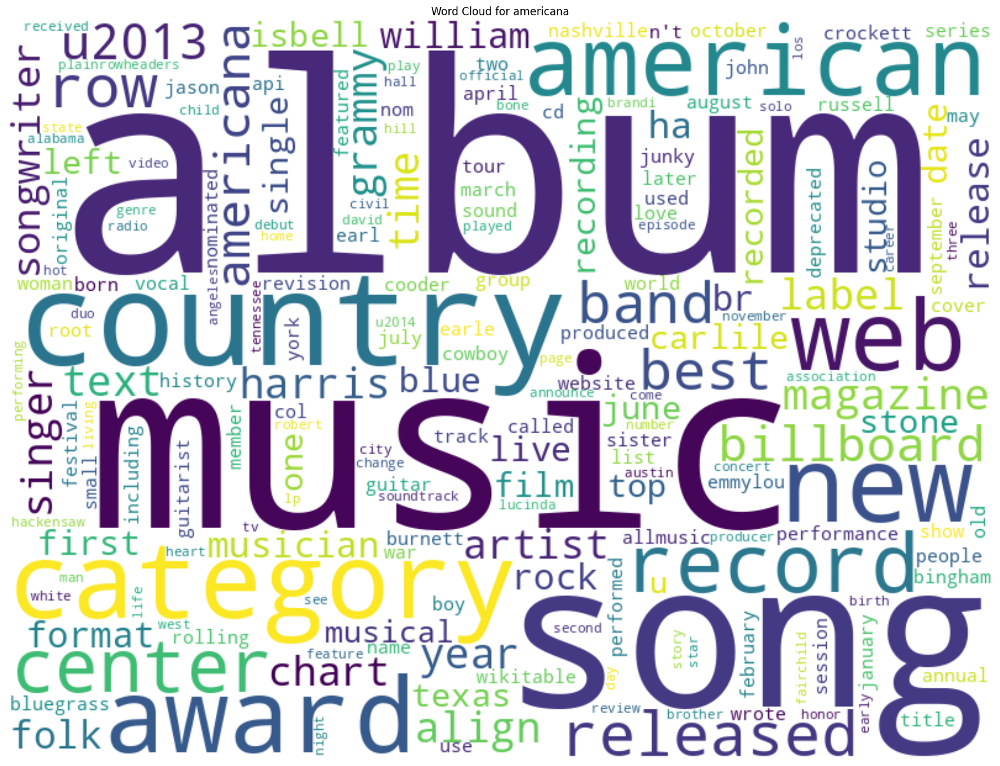

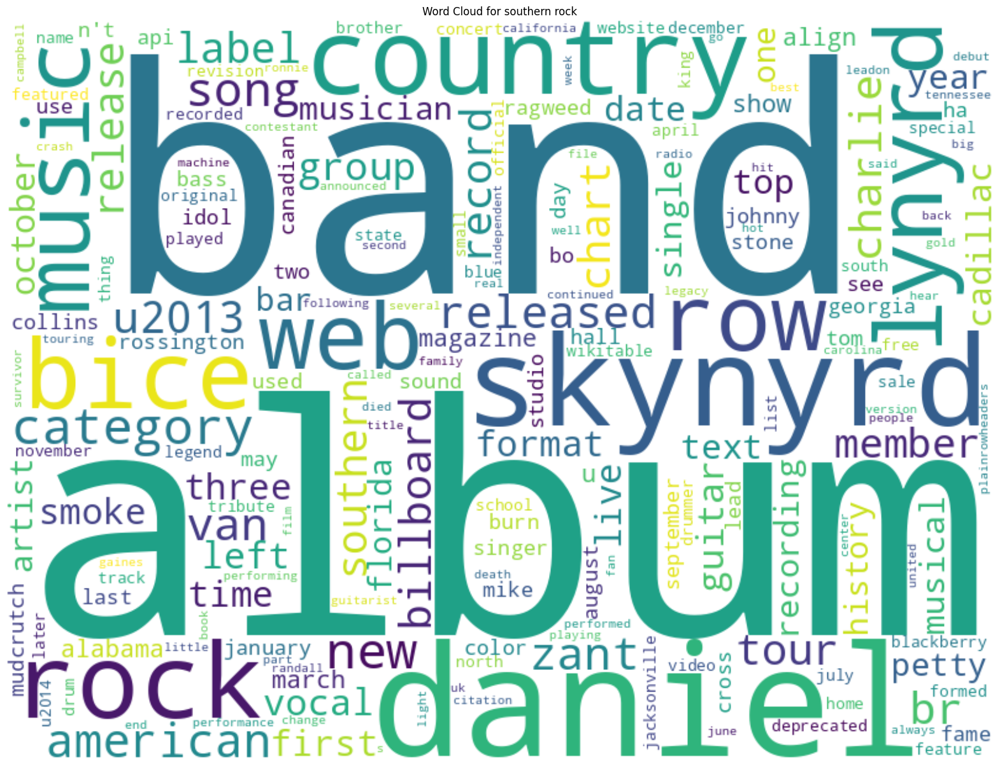

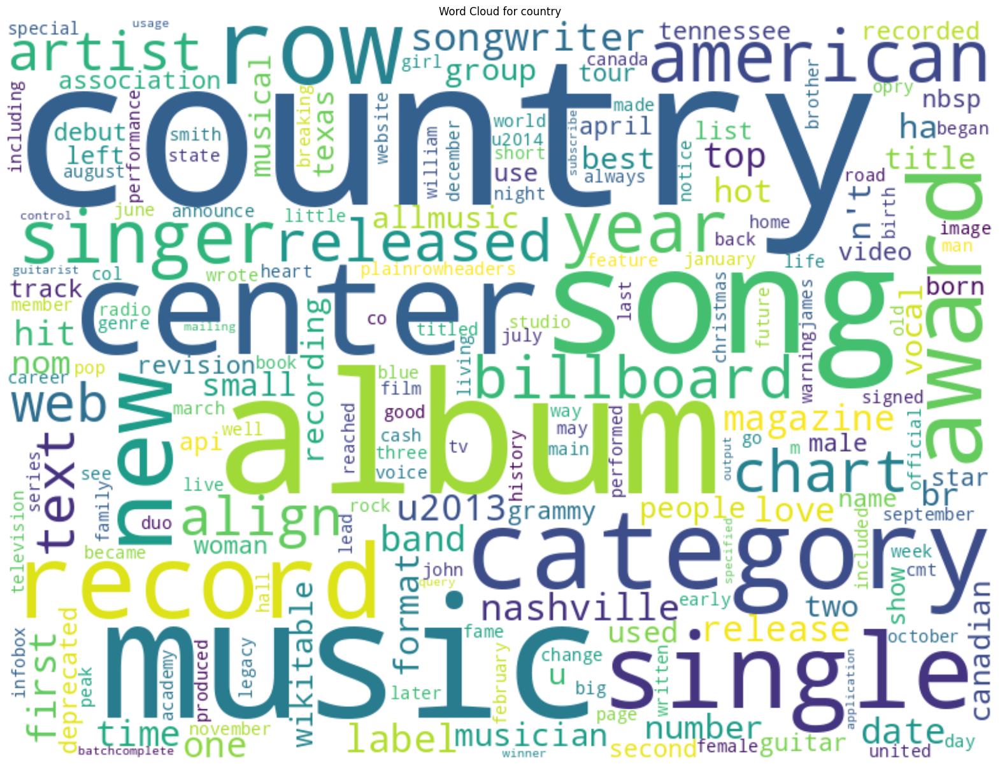

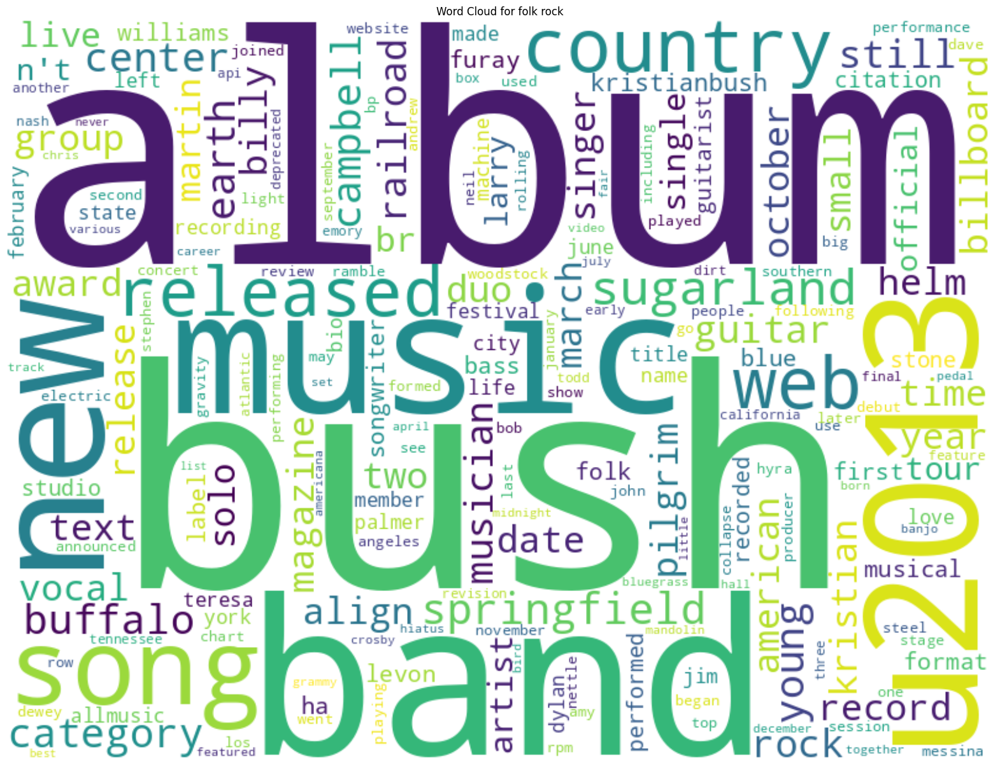

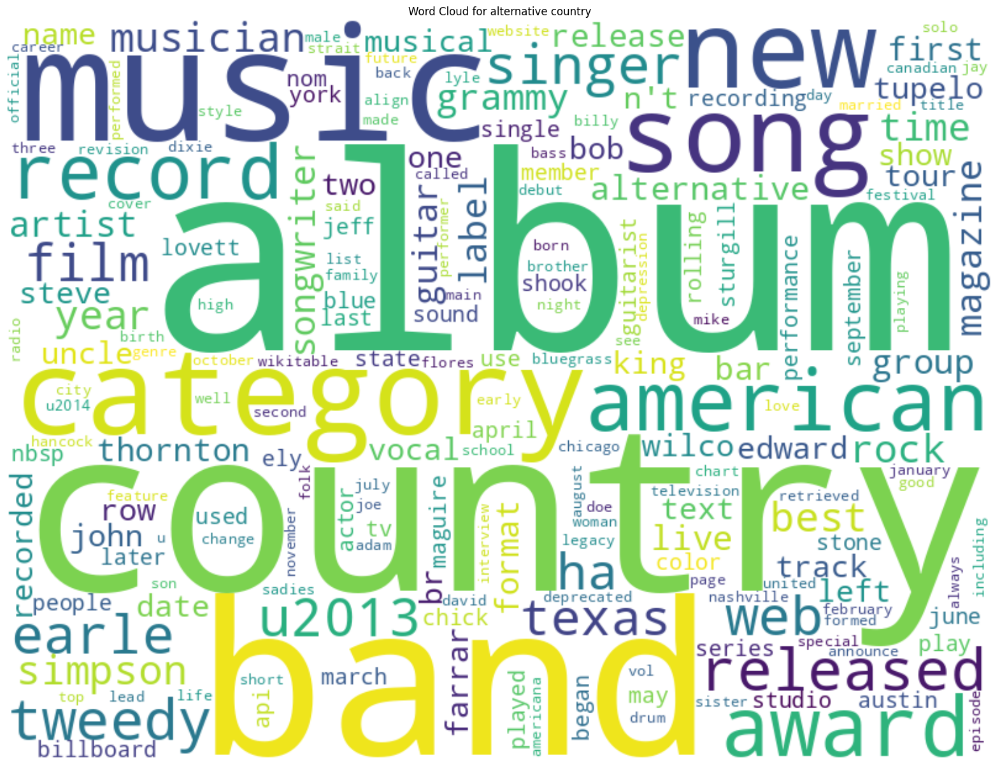

...

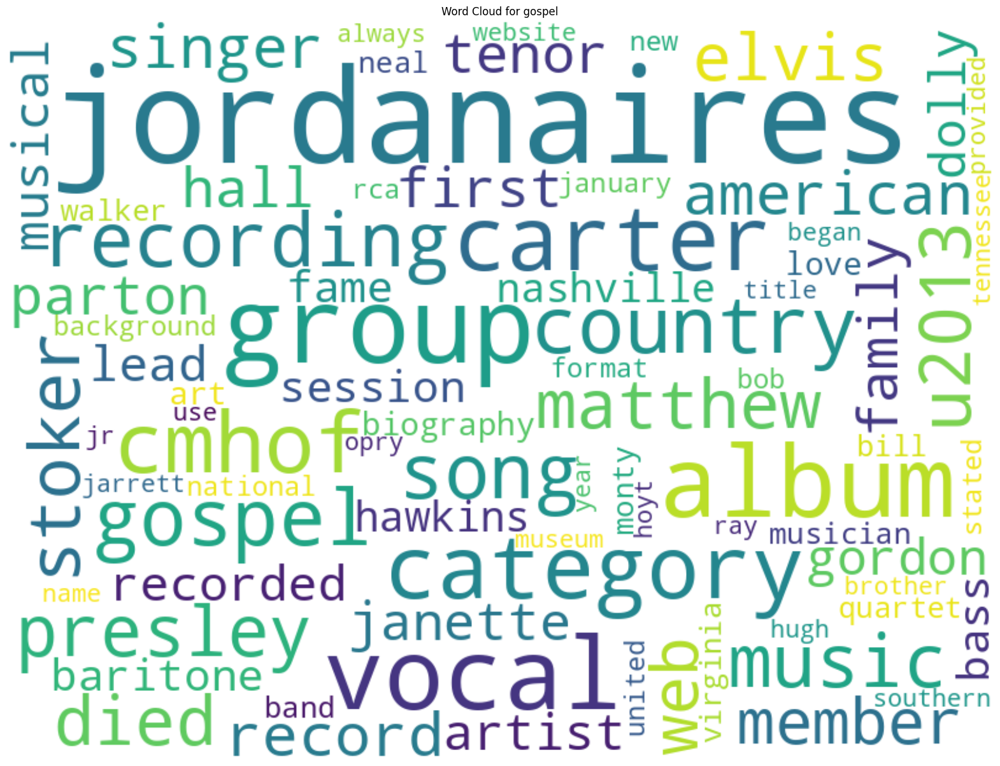

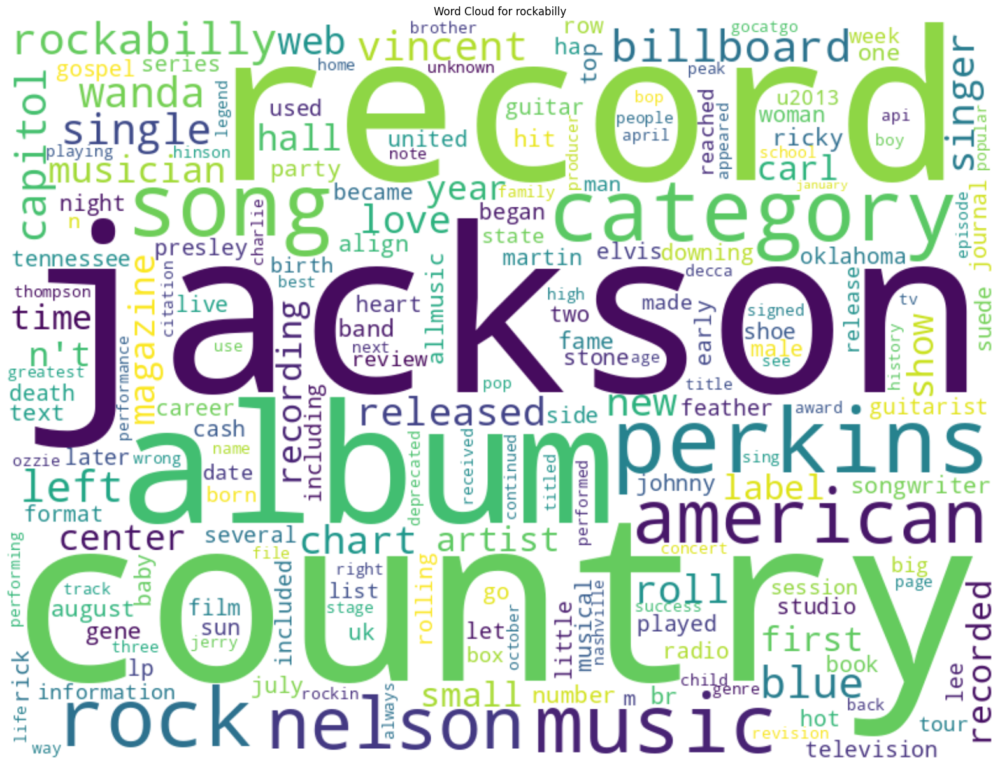

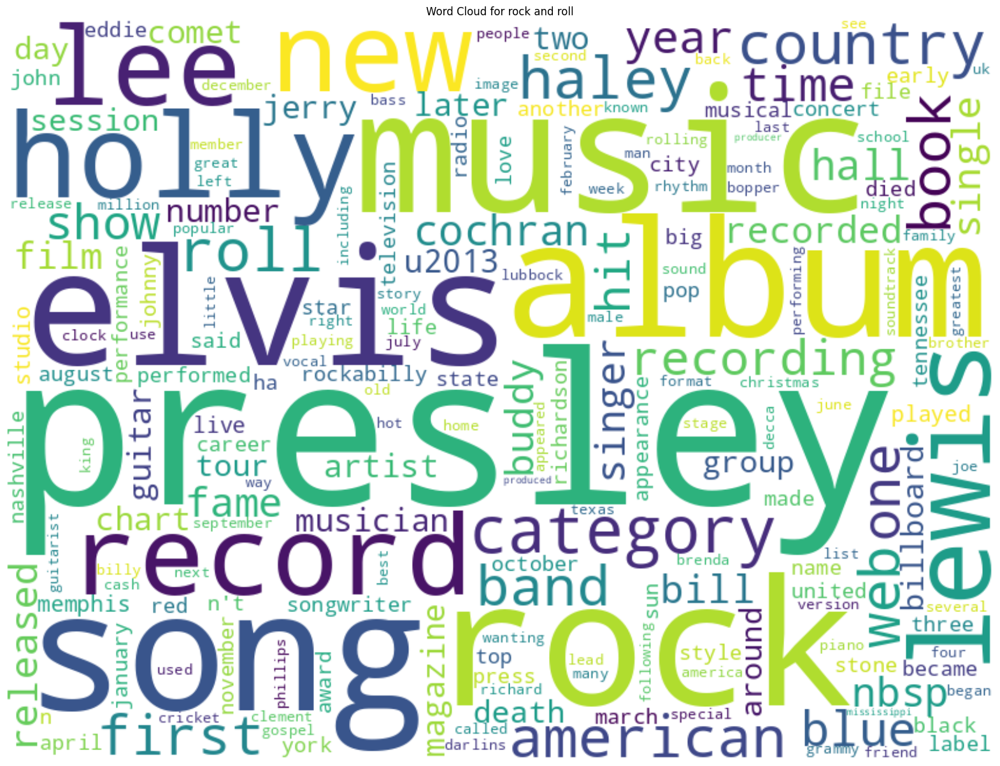

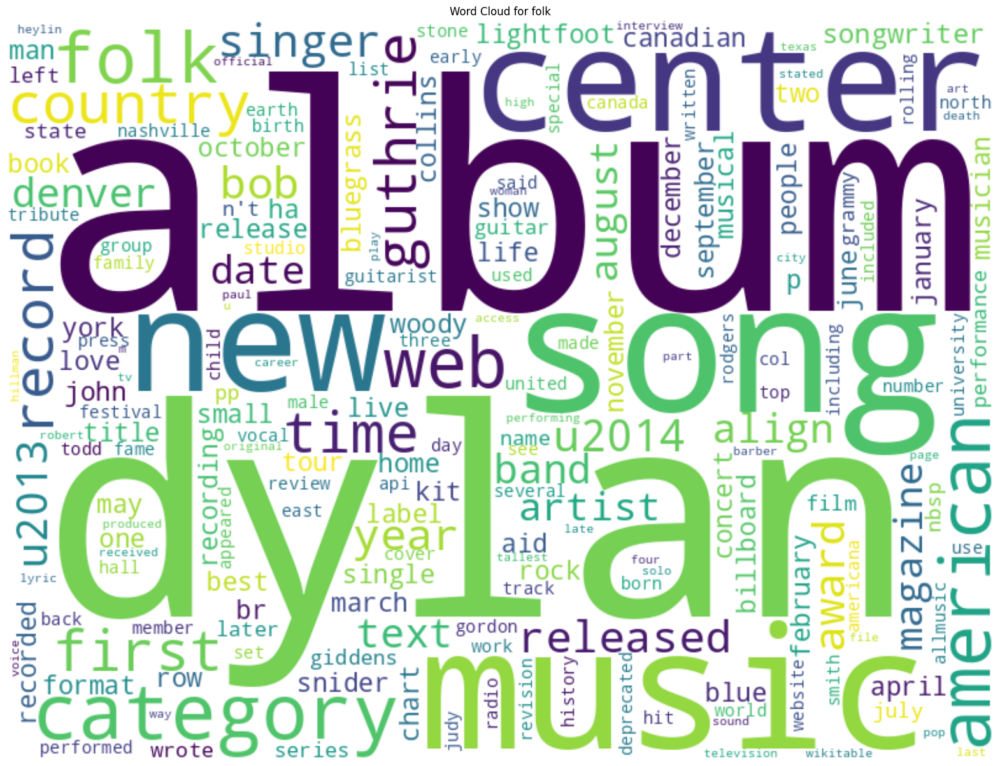

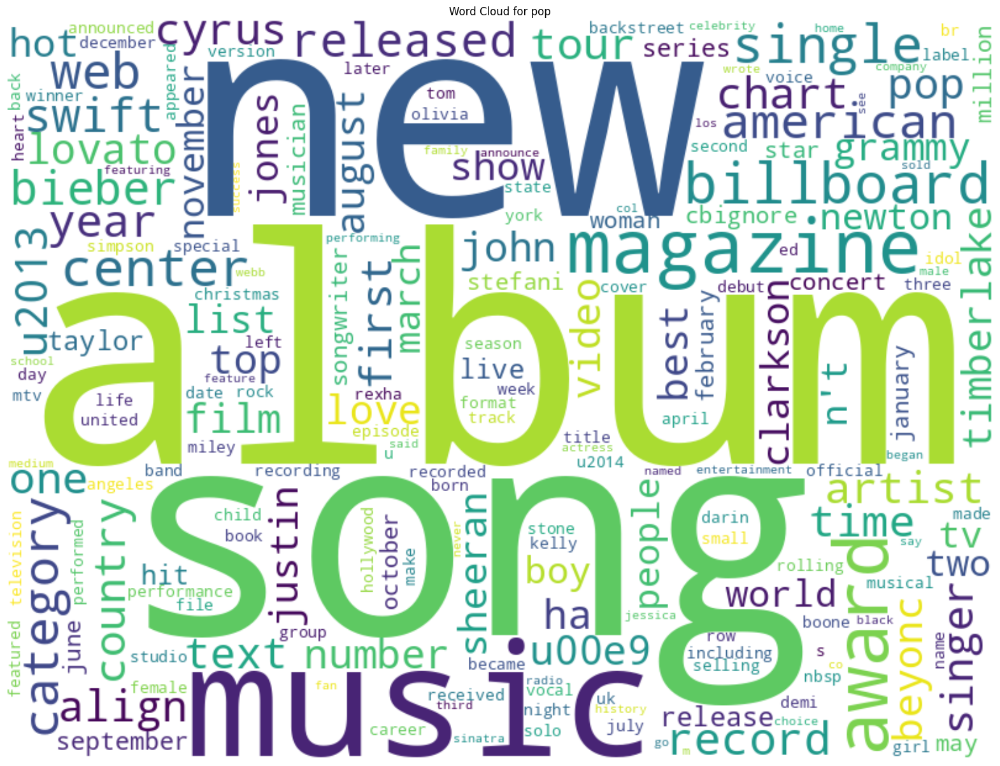

In [95]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import math

# create a word cloud for every genre in tf
for filename in os.listdir('tf'):
    # Prepare the string for the word cloud
    word_string = ""

    with open(f'tf_raw_counts/{filename}', 'r') as file:
        for line in file:
            word, count = line.split()
            count = int(math.ceil(float(count)))  # Round the count up to nearest integer
            word_string += (word + " ") * count  # Repeat the word by its count

    # Generate the word cloud
    wordcloud = WordCloud(collocations=False, background_color='white', width=800, height=600).generate(word_string)

    # Visualize the word cloud
    plt.figure(figsize=(20, 20))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')  # Turn off the axis
    plt.title(f"Word Cloud for {filename[:-4].replace('_', ' ')}")
    plt.show()

## Part 5: Understanding TF-IDF

**Definition**
* TF-IDF stands for Term Frequency - Inverse Document Frequency. It’s a way to figure out which words in a bunch of documents (like a collection of articles or a set of web pages) are the most important or relevant.

**Pick one of the alternative term frequency definitions. Explain why it might sometimes be prefereable to the raw count.**
* One alternative term frequency definitions that is not raw counts could be the frequency, or therefore the term frequency which is the raw count of a word (token) in a document divided by the total number of words (tokens) in that given document. For both counts the number of occurences is taken into account, so like the overall count of words is used. For example if a document of a food recipe has a total of 100 words and the word 'grams' occurs 15 times, the term frequency is 0.15.  
* Frequency might be preferable to raw counts due to normalization. If you just use raw counts, longer documents are likely to have higher counts for all words, simply because they have more words in general. This can make longer documents seem more important or relevant when  it does not have to be that way.

**What does IDF stand for? Answer in your own words.**
* So IDF measures how rare or special a word is across multiple documents.

**How does IDF draw on a larger corpus to extract what's special a certain text? Answer in your own words.**
* It does it by calculating the frequency of a word given a collection of documents. So if a word is recurrent in many documents of the collection it is not very important, but if the word only appears in a couple of documents it is then considered important.

**All of the IDF versions take the log of the calculated weight. Why do you think that is?**
* I belive the log is used because there is a invisible threshold where no matter if a word appears in most of the document os all of the documents it is just not overall rare. So the log scale allows to remove the importance of the words that always appear of at least it does it frequently, since the log of 1 is 0. And contrarly it gives more importance to the words that appear in fewer documents. 

**Explain why using IDF makes stopword removal less important.**
It is less important now since they appear in all the documents their idf score is usually 0, so they are automatically 'removed'.



In [96]:
# List to store each document's term frequencies
documents = {}
all_words = set()  # To store all unique words in the corpus
num_documents = 15  # Total number of documents

# calculate the tf_idf for every genre
for filename in os.listdir('tf_term_freqs'):
    doc_tf = {}
    # remove .txt from the filename
    filename_idx = filename[:-4]

    # read the file
    with open(f'tf_term_freqs/{filename}', 'r') as f:
        for line in f:
            word, tf = line.split()
            tf = float(tf)  # Convert TF to float
            doc_tf[word] = tf
            all_words.add(word)

    documents[filename_idx] = doc_tf

# Calculate IDF for each word
# IDF = log(Total number of documents / Number of documents containing the word)

idf = {}
for word in all_words:
    # Count how many documents contain the word
    doc_count = sum(1 for doc in documents if word in doc)
    # to prevent division by zero
    if doc_count > 0:
        idf[word] = math.log(num_documents / doc_count)
    else:
        idf[word] = 0

# Calculate TF-IDF for each word in each document
tf_idf = {}

for doc_name, doc_tf in documents.items():
    doc_tf_idf = {}
    for word, tf in doc_tf.items():
        # Calculate TF-IDF for the word in the current document
        tf_idf_value = tf * idf[word]  # TF * IDF
        doc_tf_idf[word] = tf_idf_value
    tf_idf[doc_name] = doc_tf_idf

# store the tf_idf in a file per genre
for doc_tf_idf, tf_idf_values in tf_idf.items():
    with open(f'tf_idf/{doc_tf_idf}.txt', 'w') as f:
        for word, value in tf_idf_values.items():
            f.write(f"{word}   {value:.4f}\n")

# Output the top 10 words by TF-IDF for each document
for doc_name, doc_tf_idf in tf_idf.items():
    print(f"\nTF-IDF values for Document {doc_name}:")
    # Sort the words by TF-IDF value in descending order
    sorted_words = sorted(doc_tf_idf, key=doc_tf_idf.get, reverse=True)
    for word in sorted_words[:10]:
        print(f"{word}: {doc_tf_idf[word]:.4f}")


TF-IDF values for Document americana:
american: 0.0076
country: 0.0059
americana: 0.0046
folk: 0.0029
blue: 0.0022
bluegrass: 0.0019
rock: 0.0013
alternative: 0.0008
go: 0.0008
pop: 0.0006

TF-IDF values for Document southern_rock:
american: 0.0069
country: 0.0062
southern: 0.0053
rock: 0.0041
south: 0.0019
blue: 0.0012
go: 0.0011
billy: 0.0010
roll: 0.0010
america: 0.0008

TF-IDF values for Document country:
country: 0.0137
american: 0.0065
go: 0.0010
pop: 0.0008
blue: 0.0007
billy: 0.0006
america: 0.0005
south: 0.0005
bill: 0.0005
ca: 0.0005

TF-IDF values for Document folk_rock:
billy: 0.0049
american: 0.0042
country: 0.0042
folk: 0.0022
blue: 0.0021
rock: 0.0020
go: 0.0020
southern: 0.0017
americana: 0.0013
bluegrass: 0.0013

TF-IDF values for Document alternative_country:
american: 0.0077
country: 0.0070
alternative: 0.0035
billy: 0.0017
rock: 0.0015
bluegrass: 0.0014
blue: 0.0013
folk: 0.0011
americana: 0.0011
rockabilly: 0.0009

TF-IDF values for Document rock:
american: 0.0066

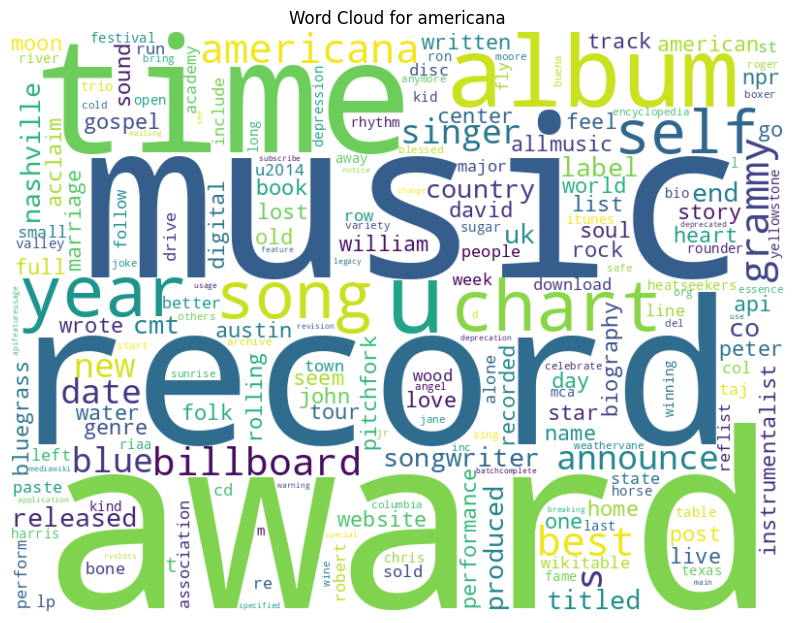

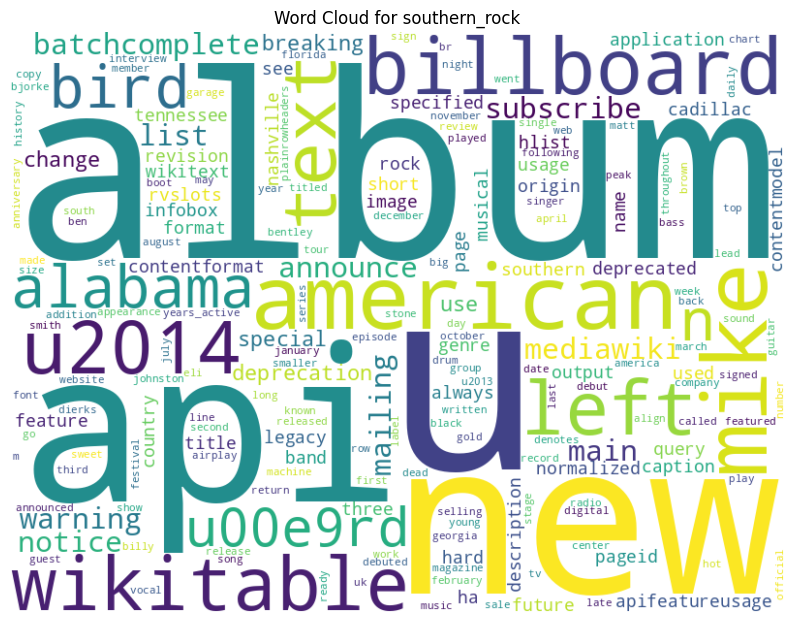

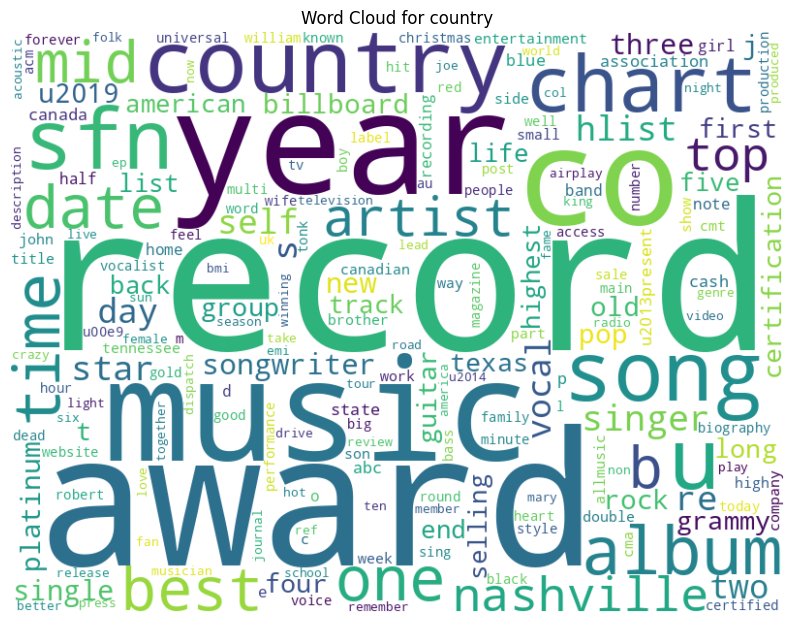

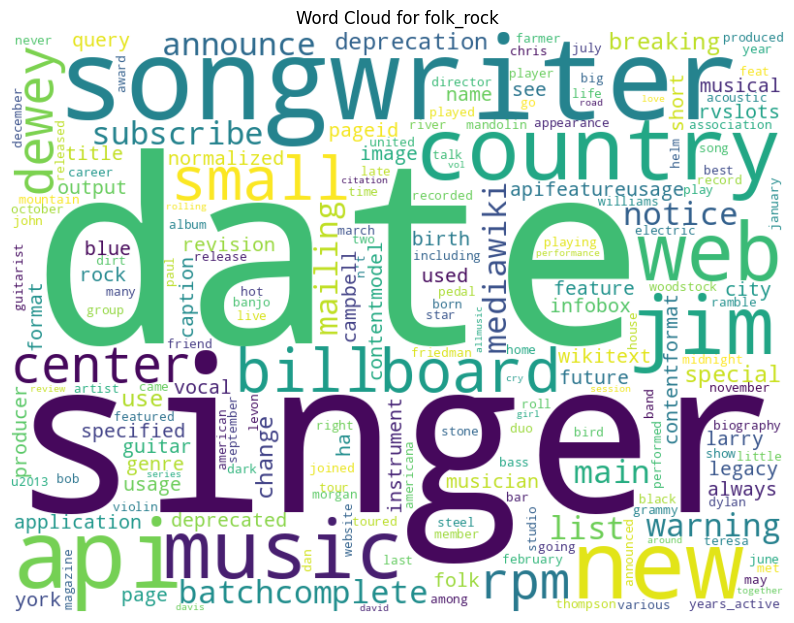

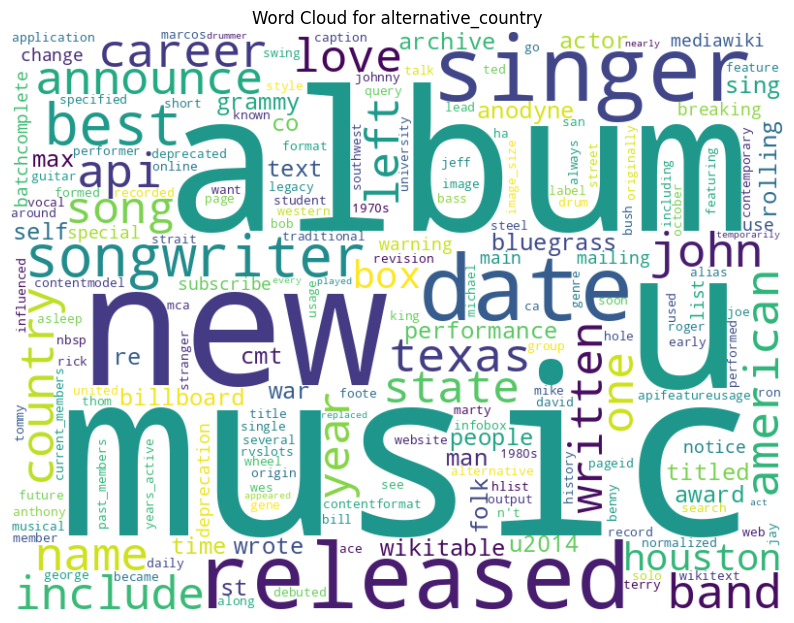

...

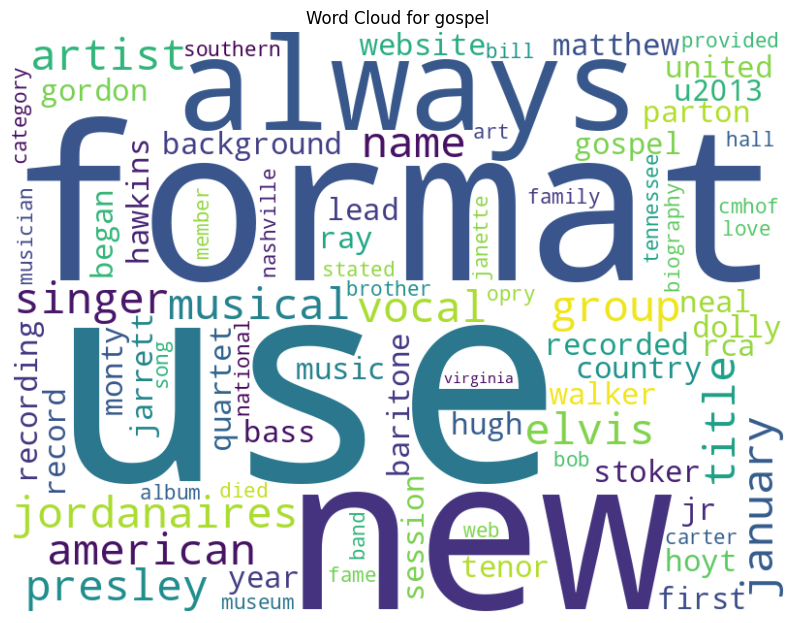

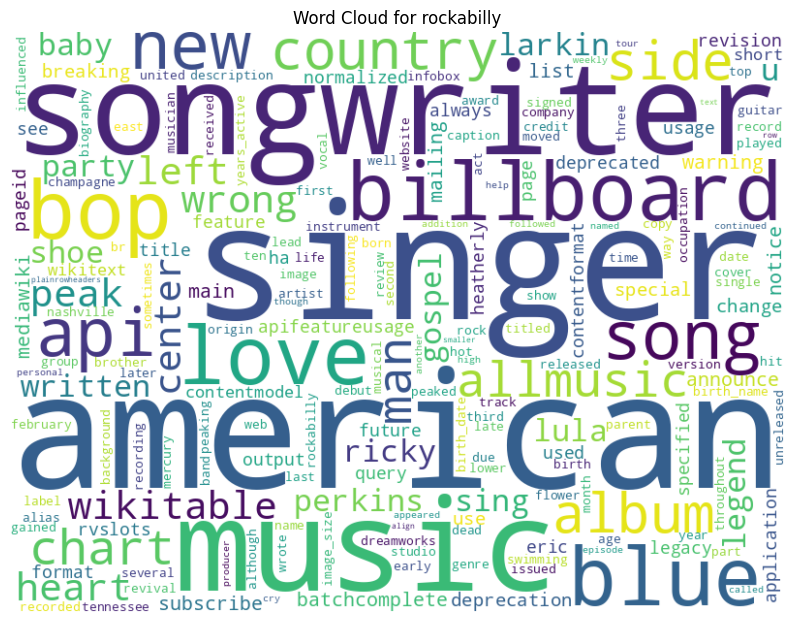

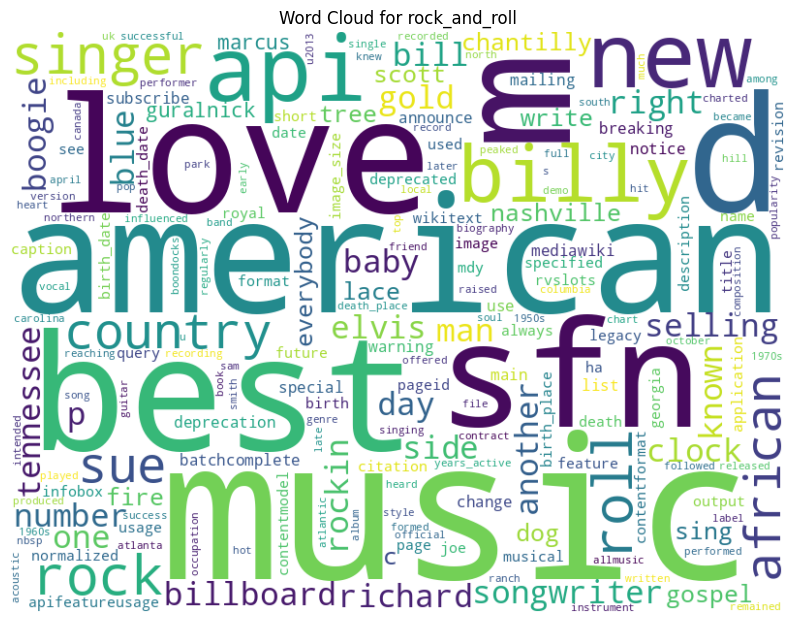

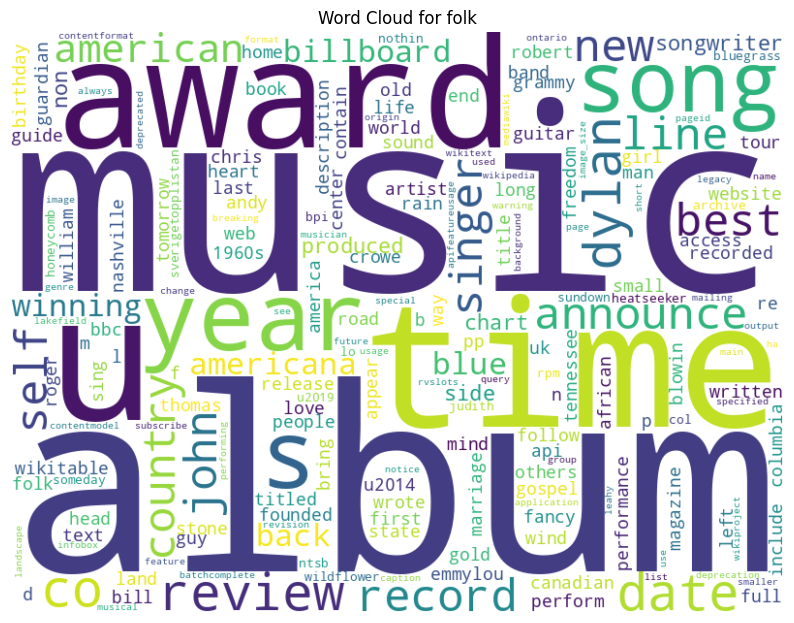

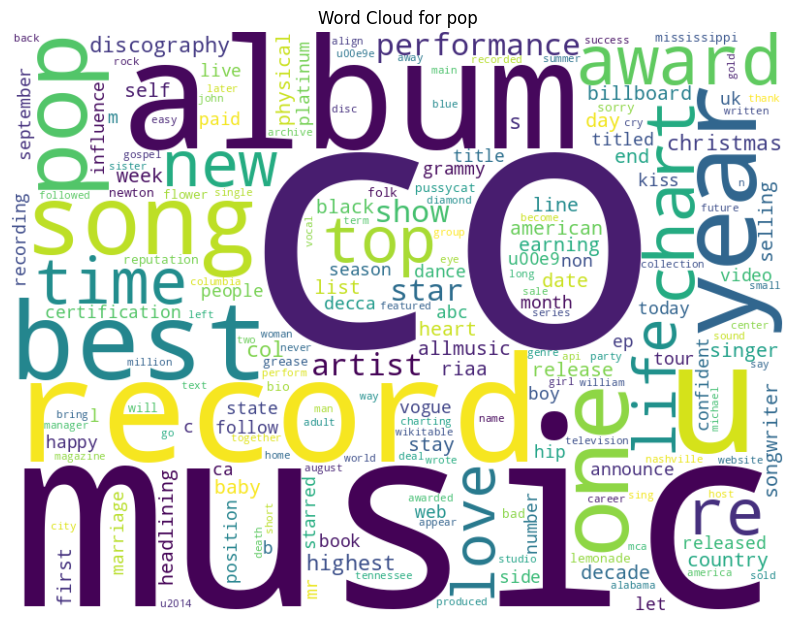

In [98]:
# Function to generate word cloud for a genre
def generate_wordcloud_for_genre(filename, output_folder='wordclouds'):
    # Create a string with each word repeated based on its TF-IDF score
    word_string = ''
    
    # Read the genre file
    with open(f'tf_idf/{filename}', 'r') as file:
        for line in file:
            word, tf_idf_value = line.split()
            tf_idf_value = float(tf_idf_value)

            # Repeat the word based on the TF-IDF score, rounded up to the nearest integer
            repeat_count = max(1, math.ceil(tf_idf_value))  # Use at least 1 if the score is very small
            word_string += (word + ' ') * repeat_count

    # Generate the word cloud
    wordcloud = WordCloud(collocations=False, background_color='white', width=800, height=600).generate(word_string)
    
    # Create output folder if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)
    
    # Save the word cloud as an image file
    genre_name = os.path.splitext(filename)[0]  # Remove file extension to get genre name
    wordcloud.to_file(f'{output_folder}/{genre_name}_wordcloud.png')
    
    # Optionally, display the word cloud
    plt.figure(figsize=(10, 8))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word Cloud for {genre_name}')
    plt.show()

# Generate word clouds for each genre file in the 'tf_idf' folder
for genre_file in os.listdir('tf_idf'):
    if genre_file.endswith('.txt'):  # Make sure we're only processing text files
        generate_wordcloud_for_genre(genre_file)